In [20]:
from datasets import load_dataset
import os
from PIL import Image
from pathlib import Path
import pandas as pd
from torchvision.transforms.functional import pil_to_tensor, to_pil_image
import cv2
import numpy as np

In [2]:
ds = load_dataset("mprzymus/text2tile")["test"]

Found cached dataset parquet (/home/marcin/.cache/huggingface/datasets/mprzymus___parquet/mprzymus--text2tile-08c7471b58d60160/0.0.0/2a3b91fbd88a2c90d1dbbb32b460cf621d31bd5b05b934492fdef7d8d6f236ec)


  0%|          | 0/2 [00:00<?, ?it/s]

OSM of area containing: 3 amenity bicycle parkings  , 2 building retails  , 1 shop hairdresser  , 2 building publics  , 10 building residentials  .


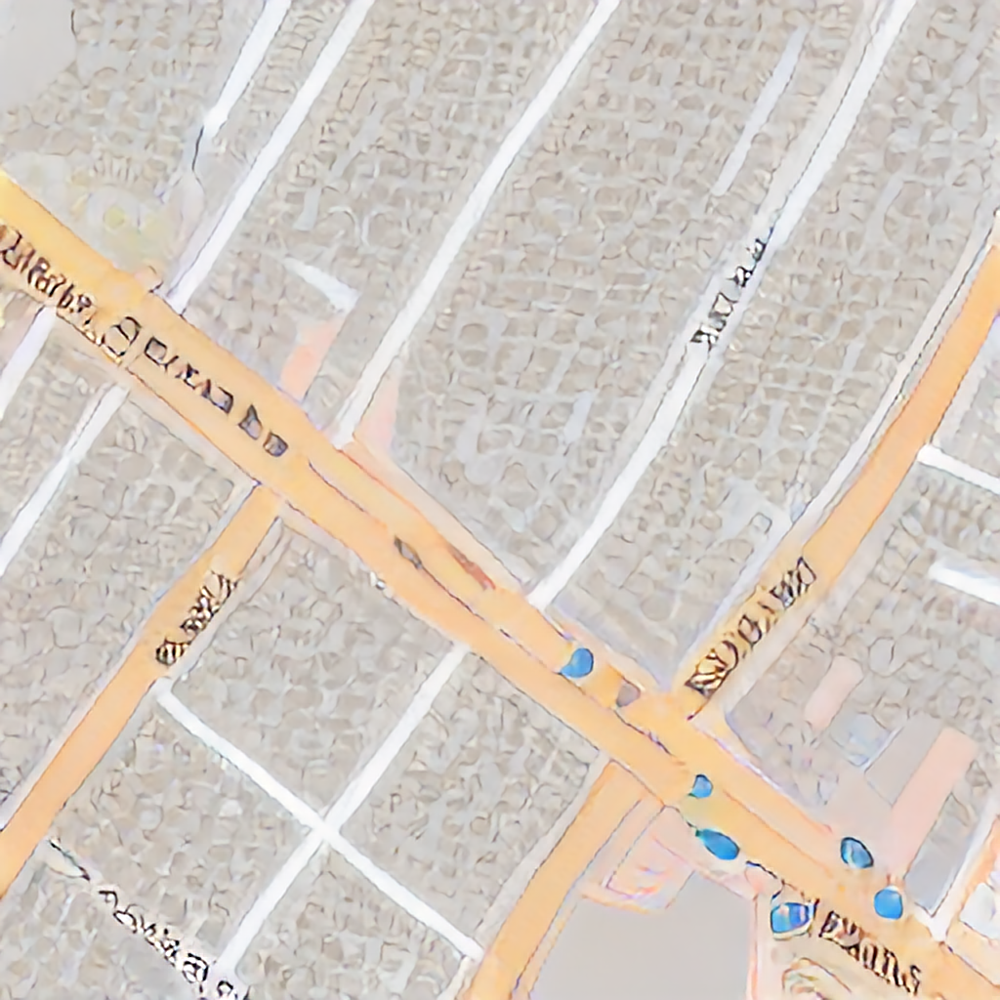

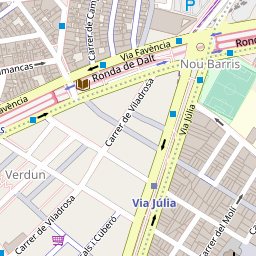

OSM of area containing: 1 leisure playground  , 1 sport basketball  , 86 buildings  , 6 leisure pitchs  , 1 sport running  .


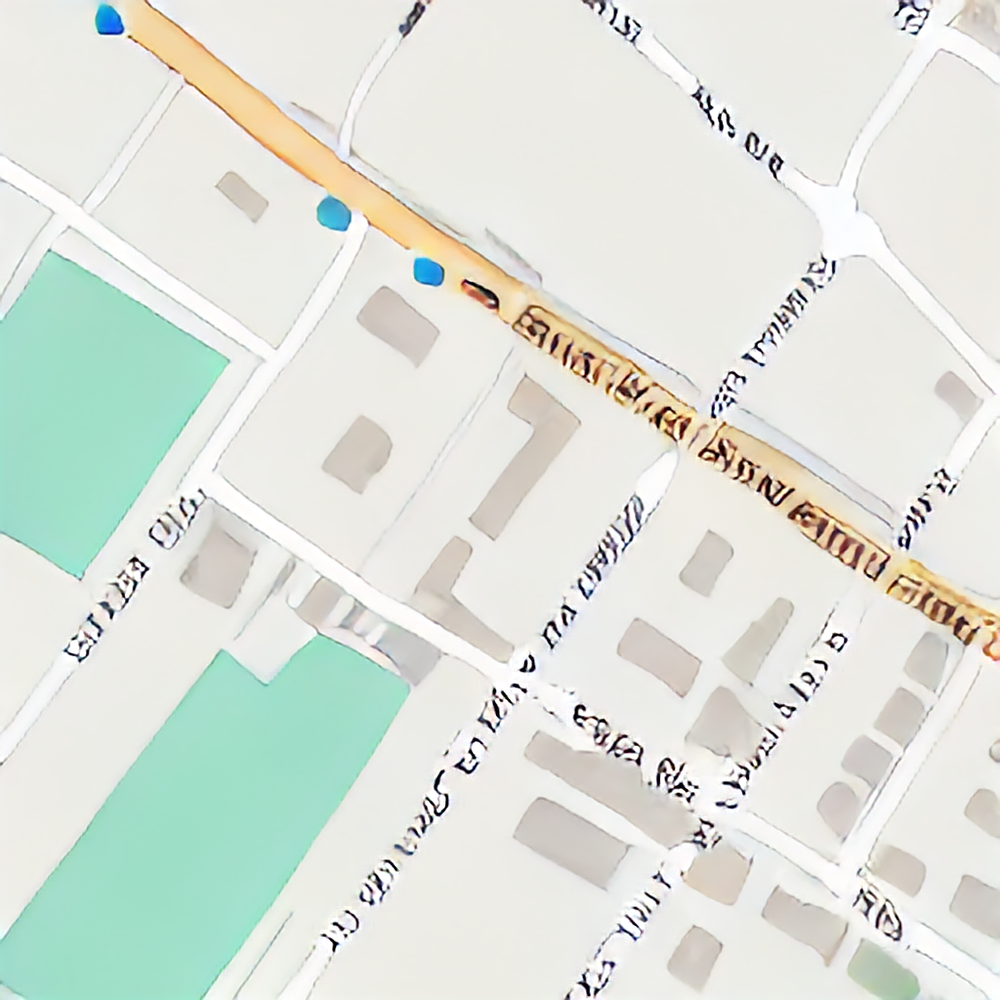

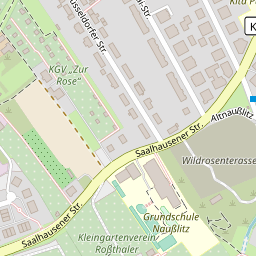

OSM of area containing: 57 buildings  , 1 building detached  , 1 building hotel  , 1 amenity parking  , 1 amenity place of worship  .


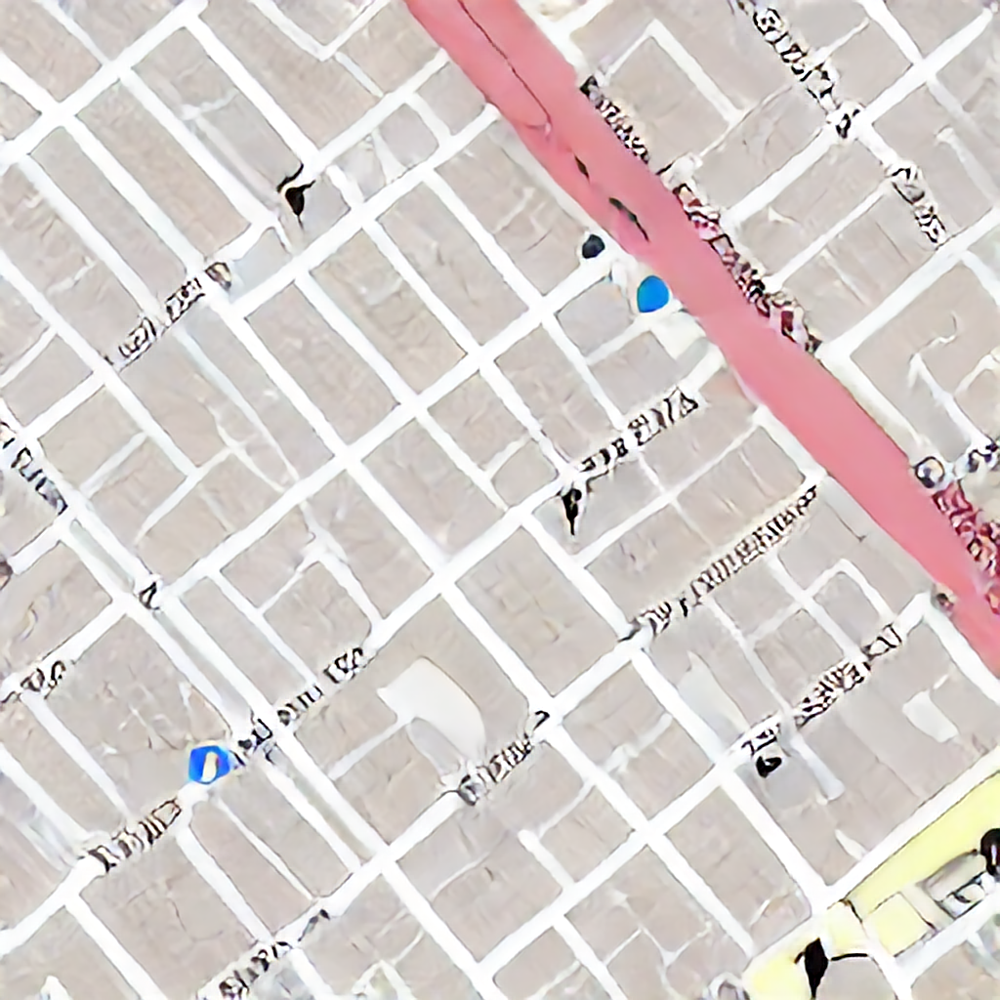

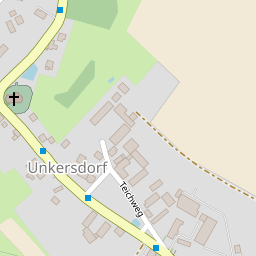

OSM of area containing: 1 amenity shelter  , 1 amenity drinking water  , 2 leisure playgrounds  , 3 building retails  , 1 building garage  .


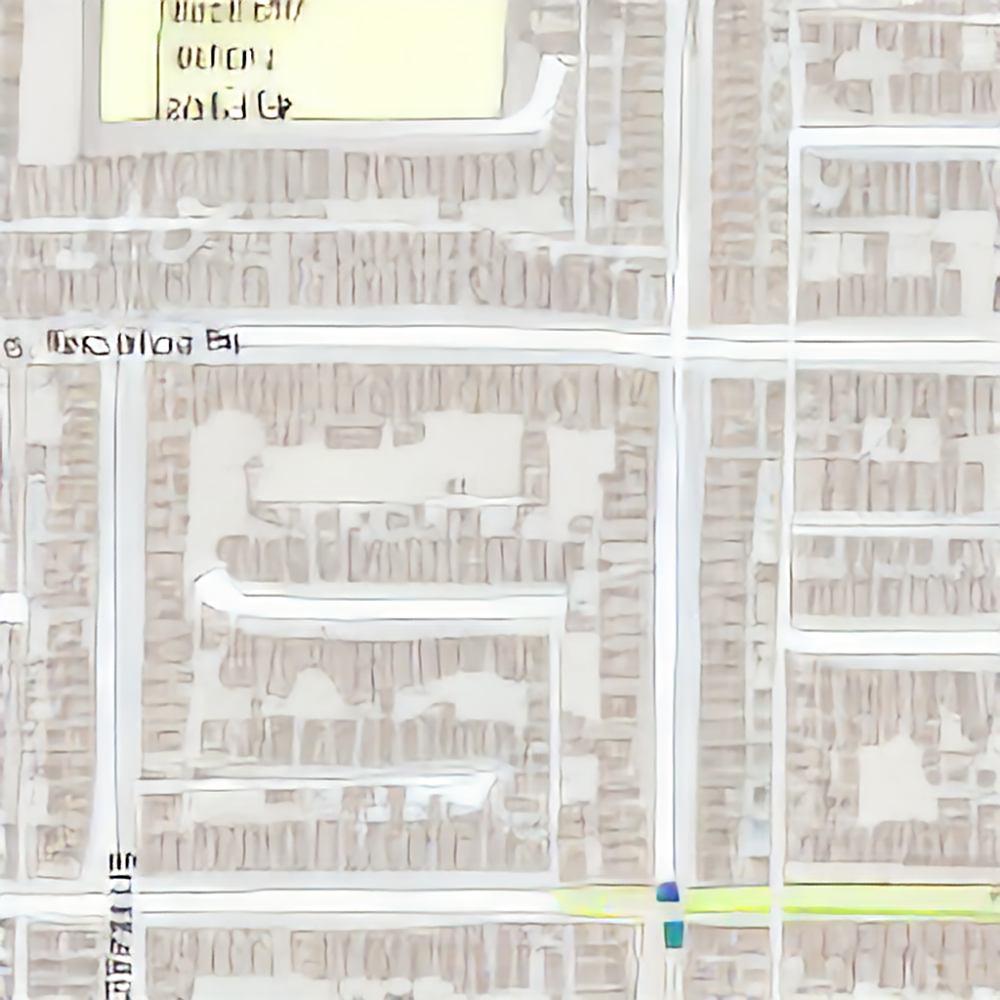

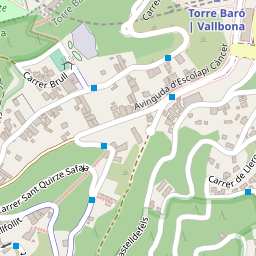

OSM of area containing: 1 landuse allotments  , 1 water river  , 9 leisure gardens  , 1 amenity cafe  , 1 leisure dog park  .


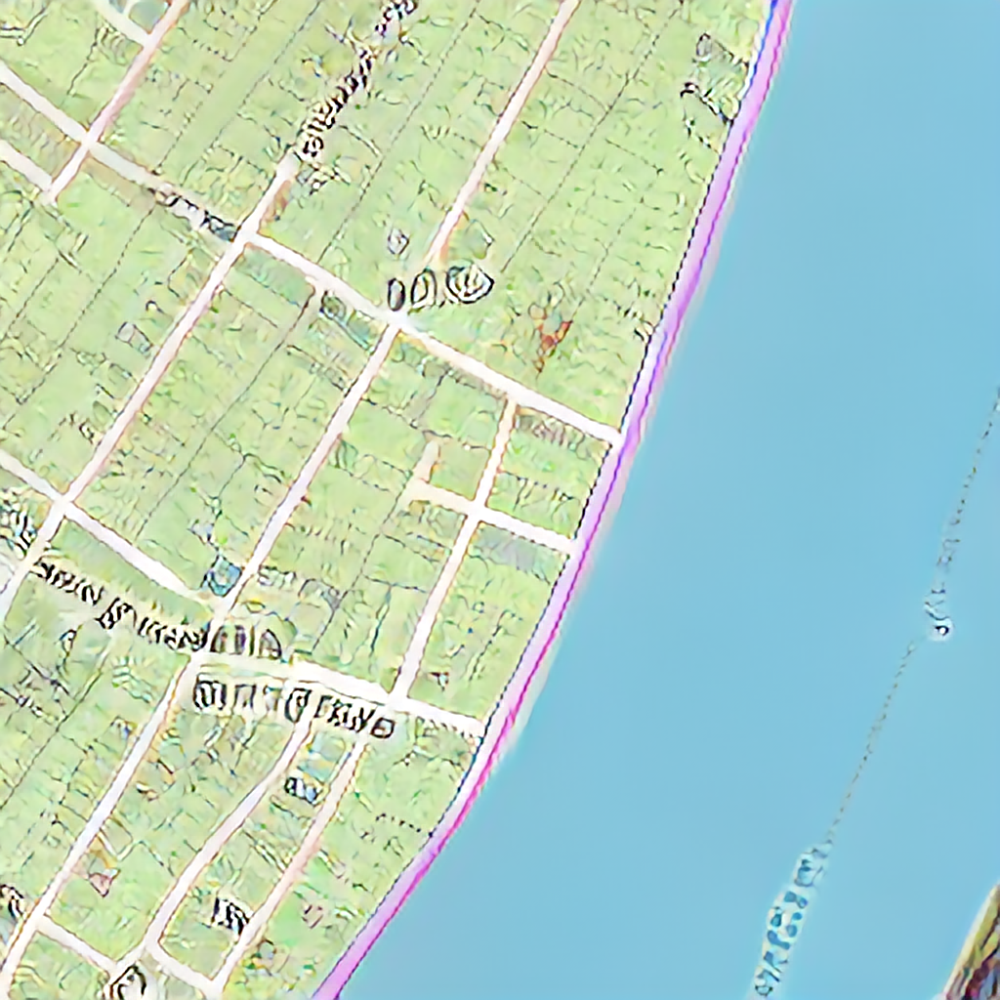

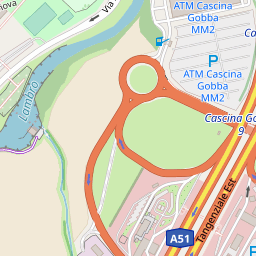

OSM of area containing: 1 building kindergarten  , 2 leisure parks  , 1 leisure track  , 53 building houses  , 5 sport soccers  .


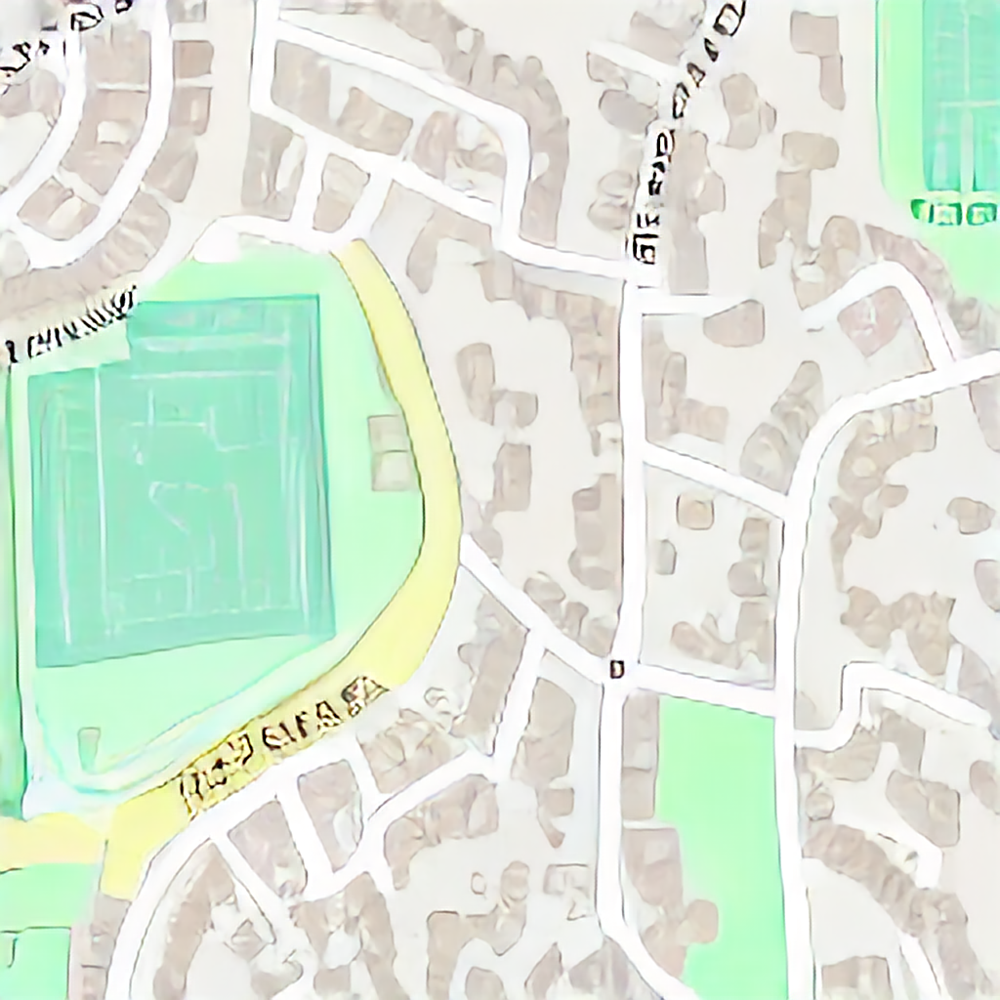

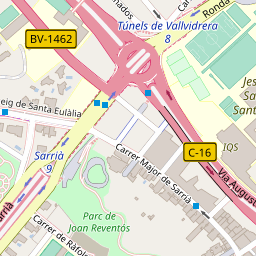

OSM of area containing: 1 building  , 1 leisure park  , 1 leisure pitch  , 1 sport soccer  .


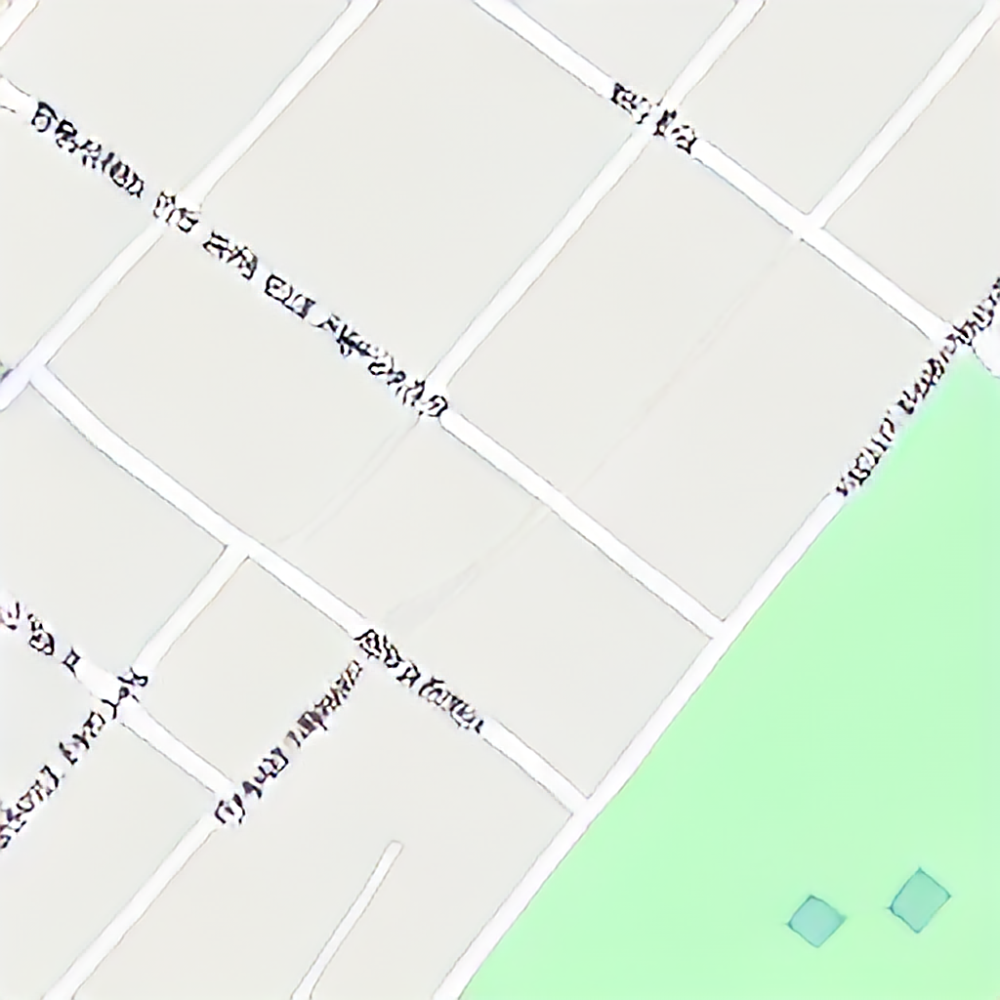

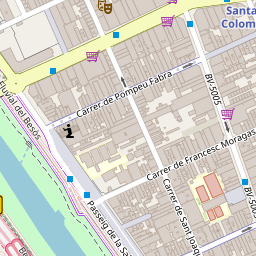

OSM of area containing: 2 amenity schools  , 1 leisure stadium  , 4 building schools  , 1 leisure fitness centre  , 1 amenity kindergarten  .


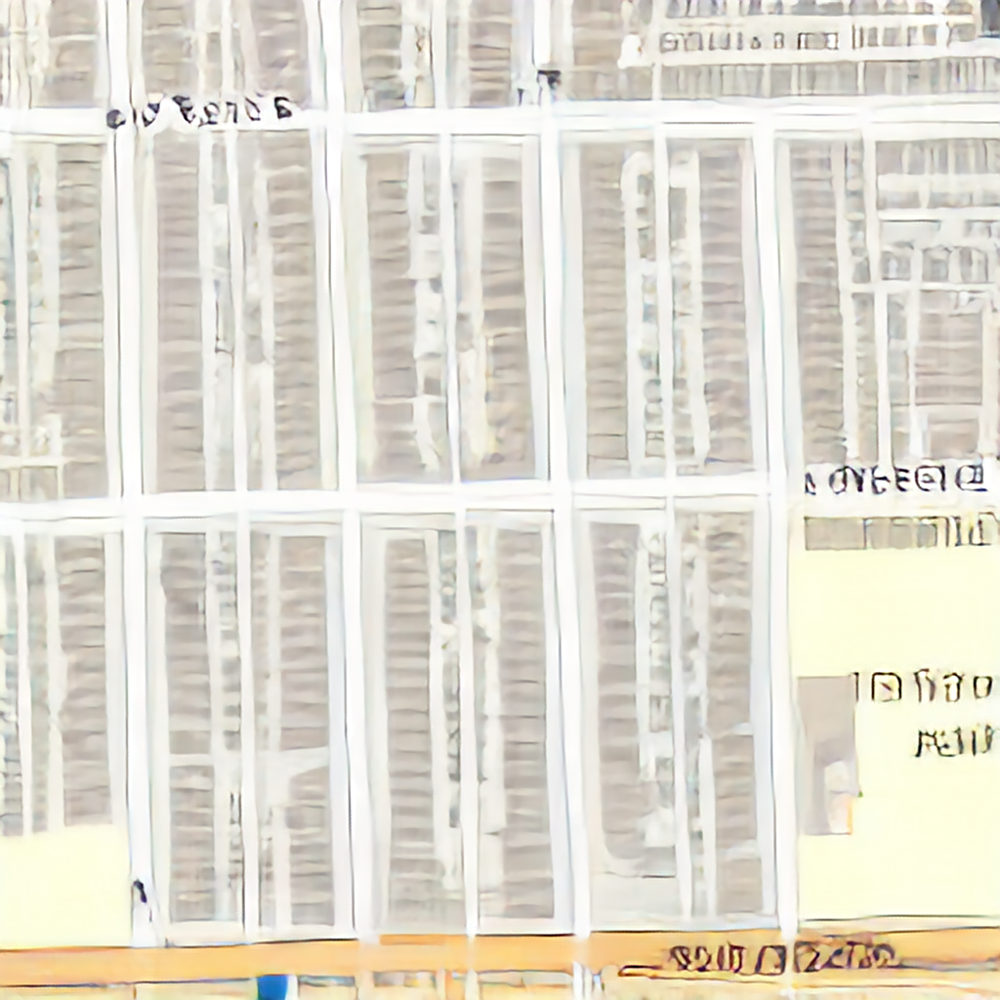

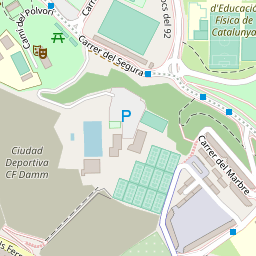

OSM of area containing: 1 amenity grit bin  , 1 landuse allotments  , 29 buildings  , 1 building garages  , 1 building roof  .


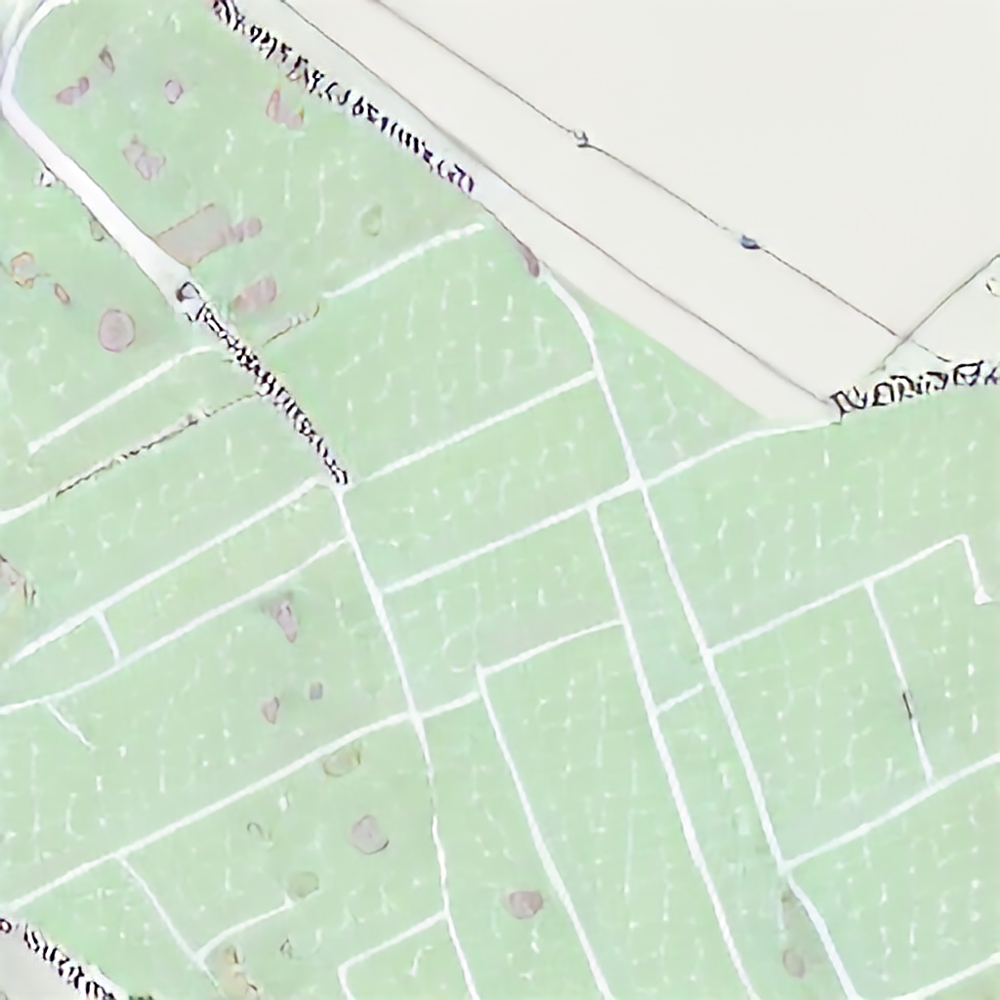

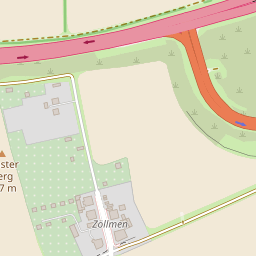

In [3]:
imgs = []
upscaled_path = Path("../../gen_upscaled")
for img_name in os.listdir(upscaled_path):
    img = Image.open(upscaled_path / img_name)
    number = int(img_name.split(".")[0])
    print(ds[number]["caption"])
    display(img)
    display(ds[number]["image"])
    imgs.append(img)

In [10]:
series = pd.Series(ds["caption"])
series[series == "OSM of area containing: 2 leisure pitches  , 191 building apartments  , 3 amenity parkings  , 1 amenity fuel  , 2 building industrials  ."]

Series([], dtype: object)

In [12]:
series[1]

'OSM of area containing: 1 landuse forest  , 1 leisure nature reserve  , 1 waterway river  .'

In [14]:
osm_tags = load_dataset("mprzymus/osm_tiles_small")["train"]
osm_tags

Found cached dataset parquet (/home/marcin/.cache/huggingface/datasets/mprzymus___parquet/mprzymus--osm_tiles_small-199229e0bb266c92/0.0.0/2a3b91fbd88a2c90d1dbbb32b460cf621d31bd5b05b934492fdef7d8d6f236ec)


  0%|          | 0/1 [00:00<?, ?it/s]

Dataset({
    features: ['image', 'aeroway_aerodrome', 'aeroway_apron', 'aeroway_gate', 'aeroway_hangar', 'aeroway_helipad', 'aeroway_heliport', 'aeroway_navigationaid', 'aeroway_runway', 'aeroway_taxiway', 'aeroway_terminal', 'aeroway_windsock', 'amenity_animal_boarding', 'amenity_animal_breeding', 'amenity_animal_shelter', 'amenity_arts_centre', 'amenity_atm', 'amenity_baby_hatch', 'amenity_bank', 'amenity_bar', 'amenity_bbq', 'amenity_bench', 'amenity_bicycle_parking', 'amenity_bicycle_rental', 'amenity_bicycle_repair_station', 'amenity_biergarten', 'amenity_boat_rental', 'amenity_boat_sharing', 'amenity_brothel', 'amenity_bureau_de_change', 'amenity_bus_station', 'amenity_cafe', 'amenity_car_rental', 'amenity_car_sharing', 'amenity_car_wash', 'amenity_casino', 'amenity_charging_station', 'amenity_childcare', 'amenity_cinema', 'amenity_clinic', 'amenity_clock', 'amenity_college', 'amenity_community_centre', 'amenity_conference_centre', 'amenity_courthouse', 'amenity_crematorium', 'a

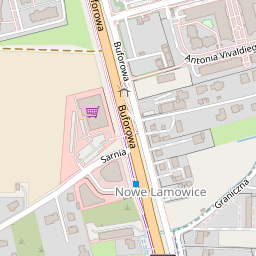

In [15]:
osm_tags[1550]["image"]

In [16]:
data = pd.Series(osm_tags[1550]).drop("image")
data = data[data != 0]

In [17]:
from map_generation.osm_dataset import create_sentence

d = pd.Series({
    "amenity_parking": 8,
    "building_detached": 14,
    "shop_supermarket": 1,
    "amenity_post_office": 1,
    "landuse_residential": 6,
})

create_sentence(d)

"amenity parking"
"building detached"
"shop supermarket"
"amenity post office"
"landuse residential"


'OSM of area containing: 8 amenity parkings , 14 building detacheds , 1 shop supermarket, 1 amenity post office, 6 landuse residentials .'

In [19]:
from map_generation.masks.model import SegmentationModel, SegmentationModule, Unet

nn = Unet([16, 32, 64, 128, 256], 1)
model = SegmentationModule.load_from_checkpoint(
    "../workflow_raster/model/segmentation_unet.ckpt", segmentation_model=SegmentationModel(nn, None)
)

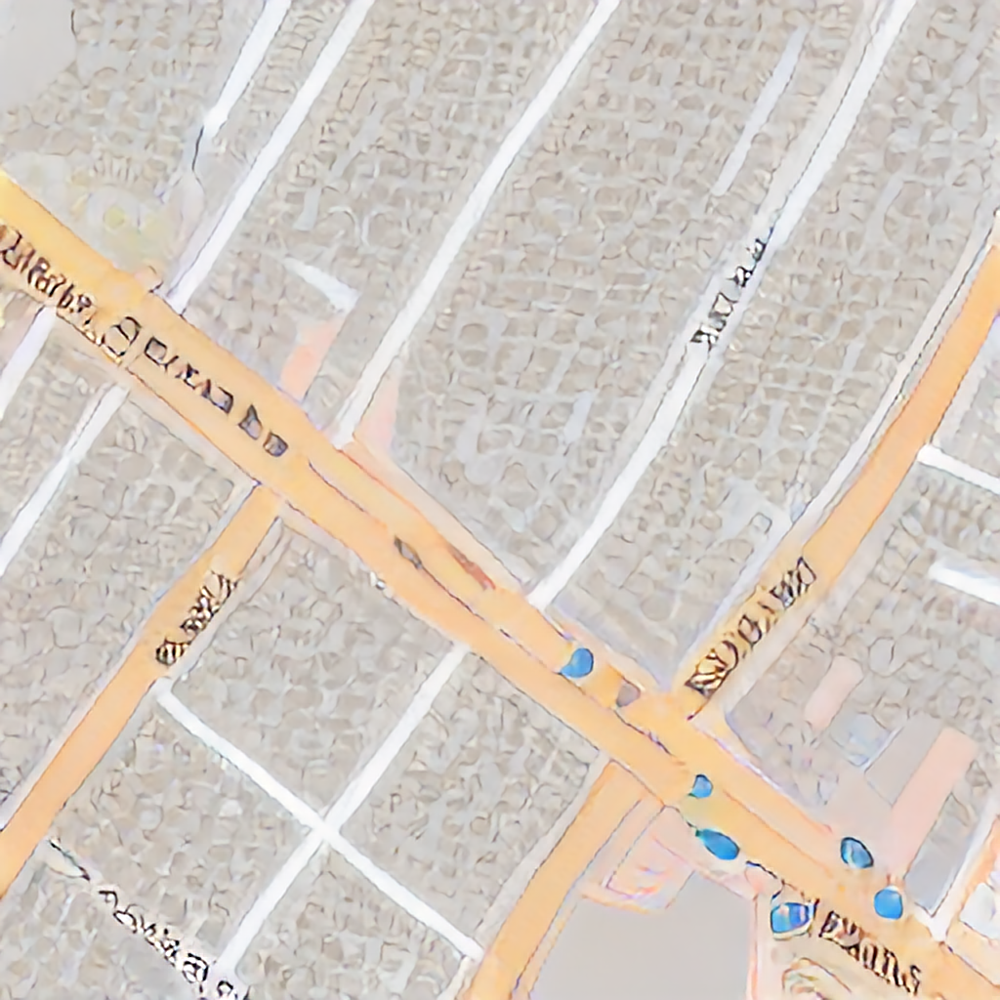

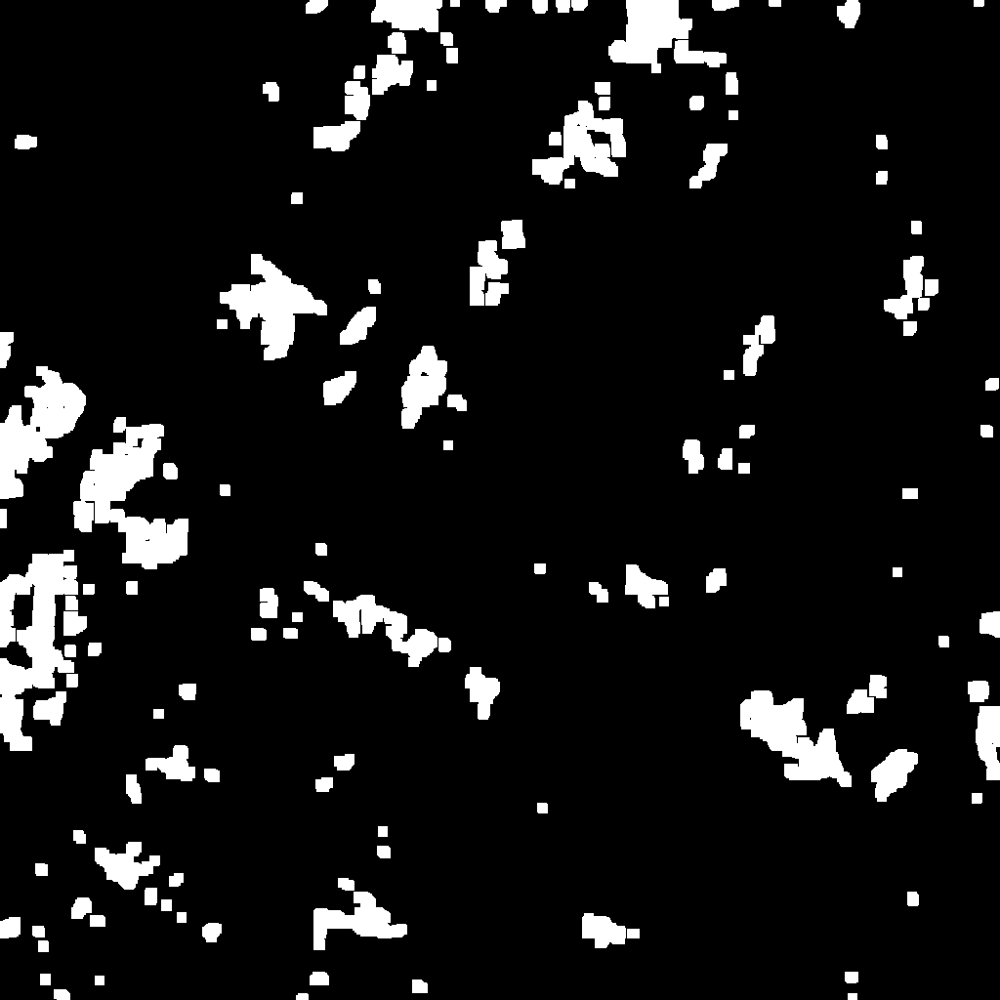

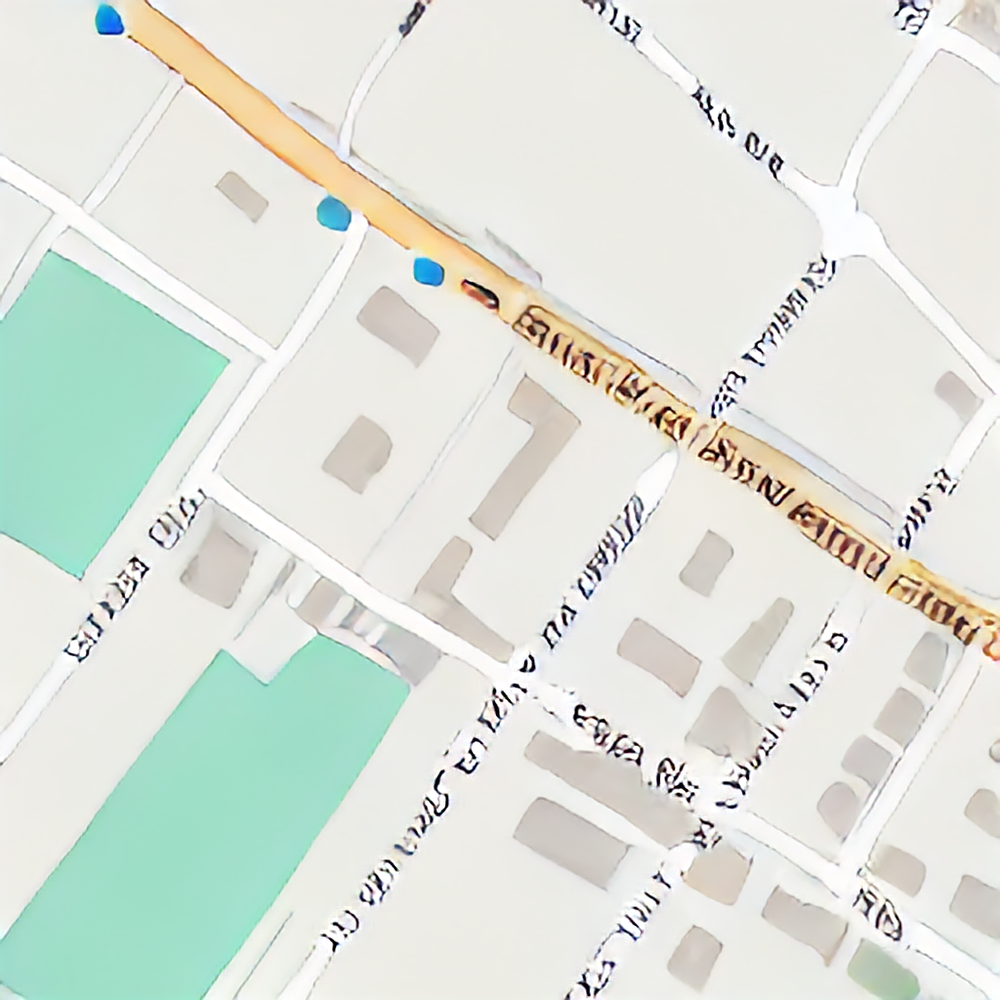

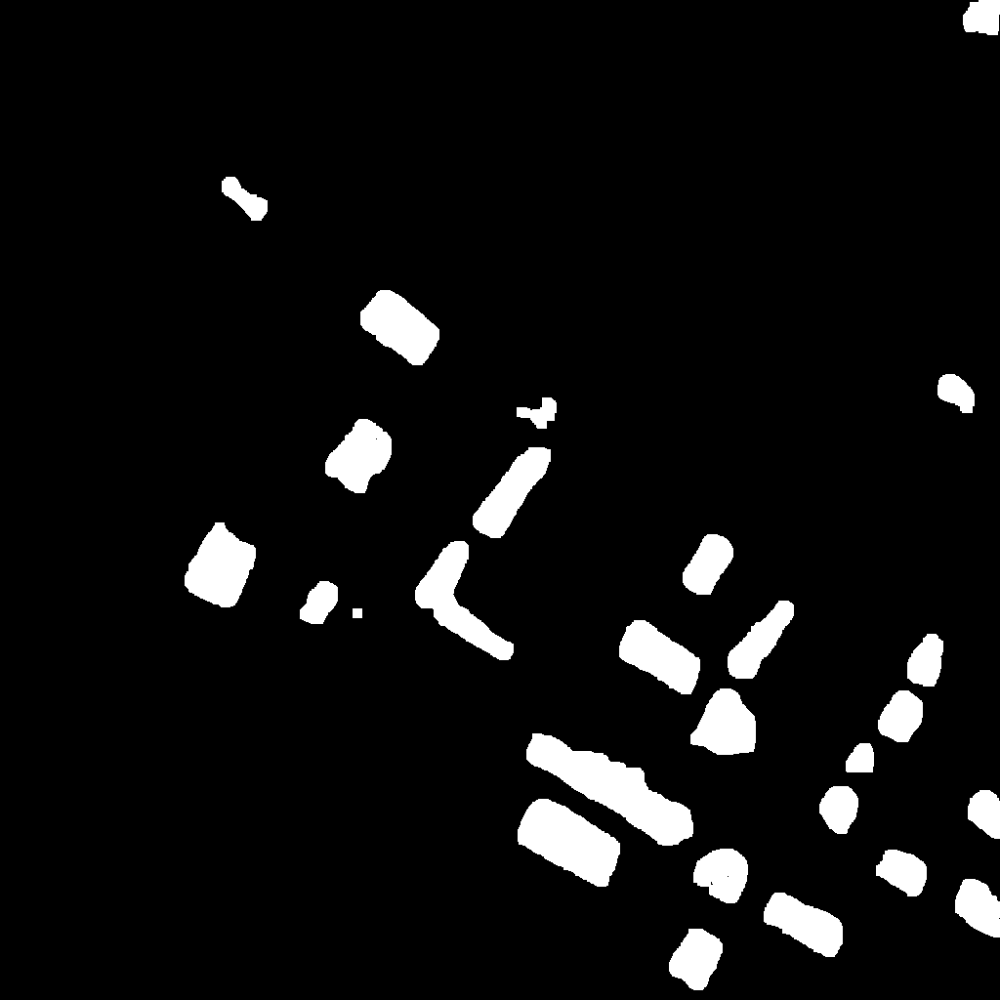

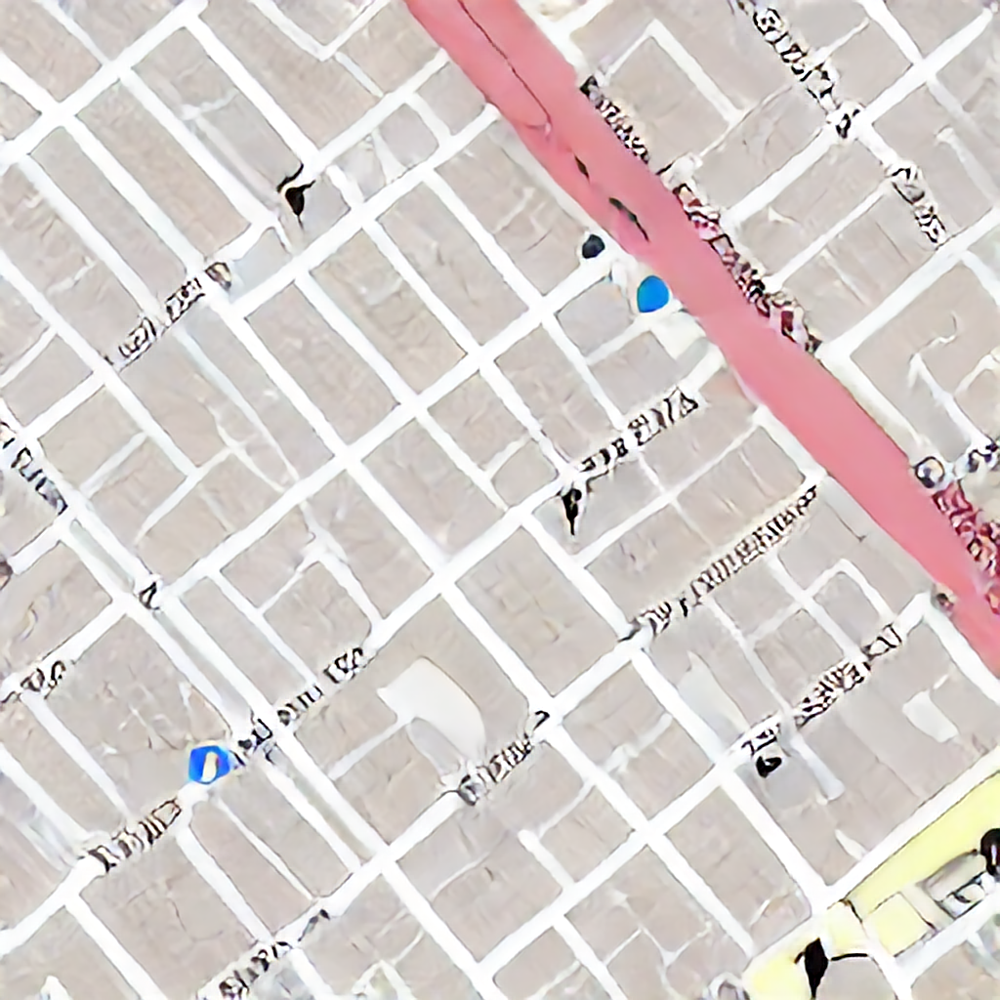

...

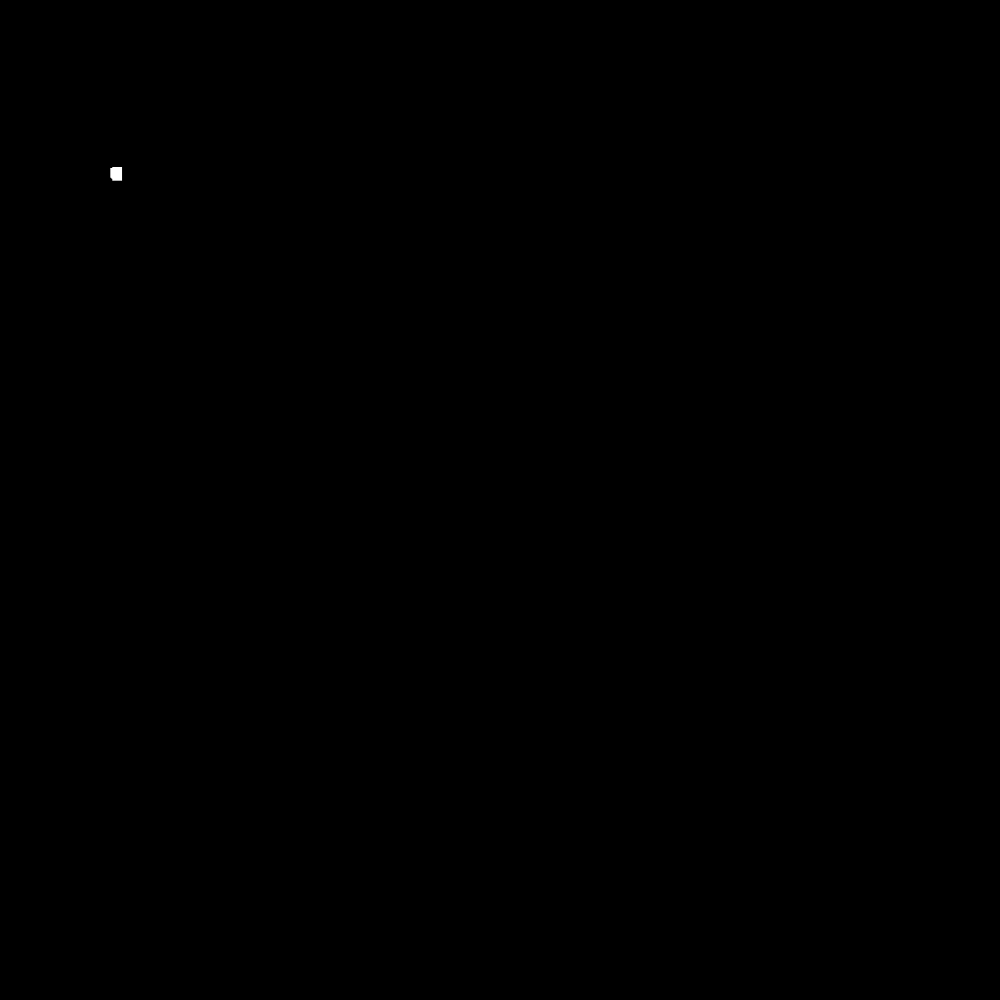

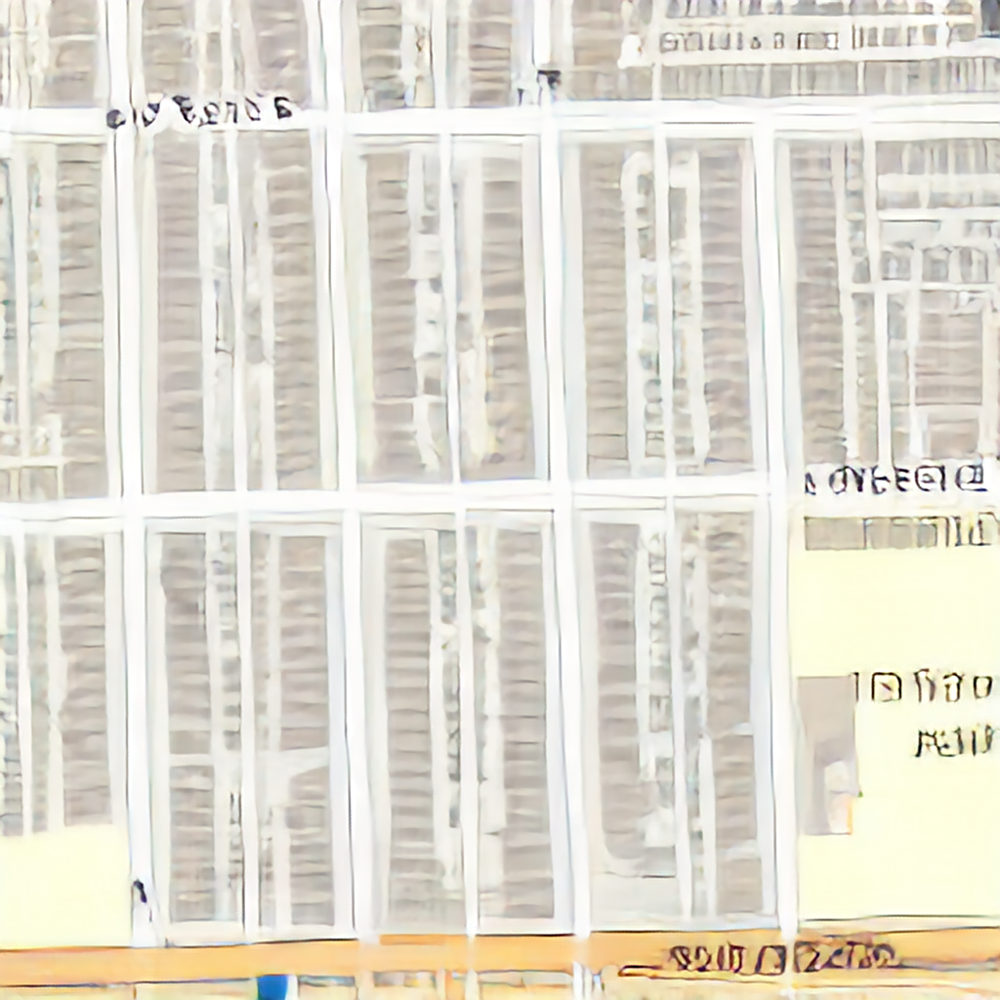

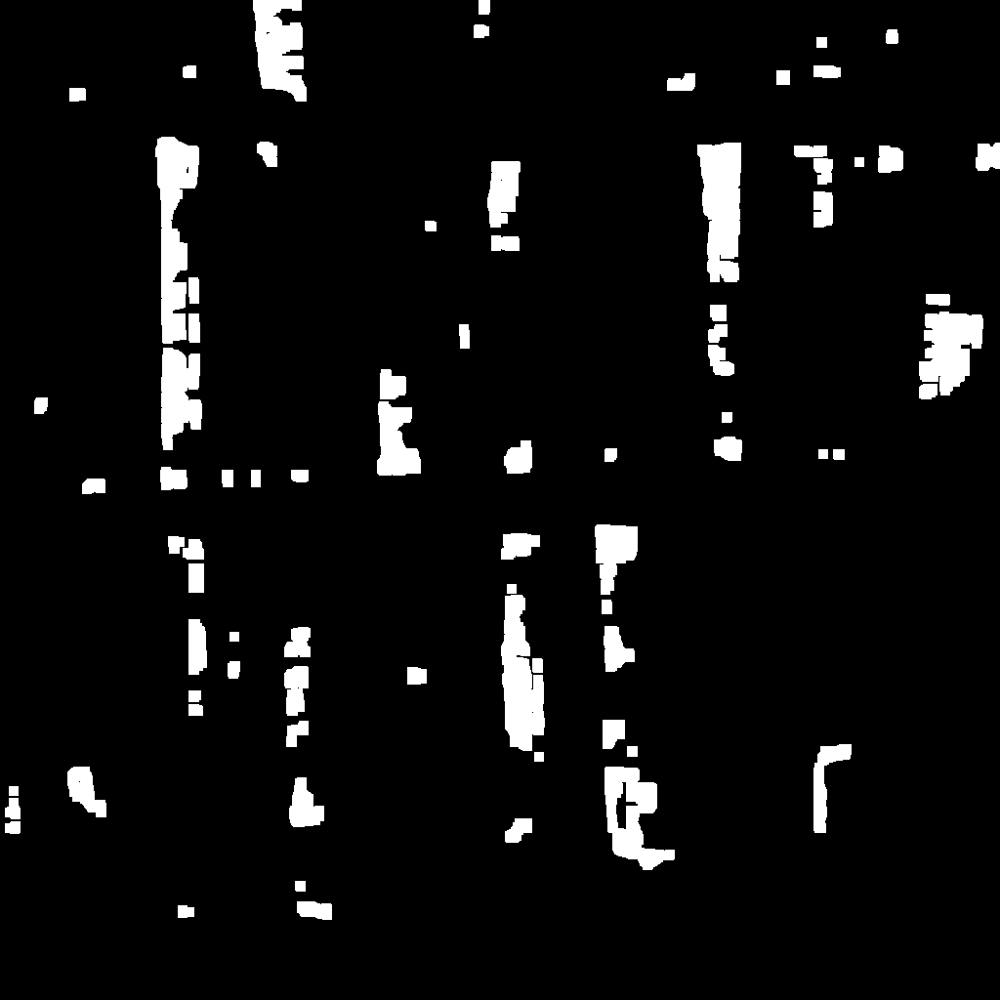

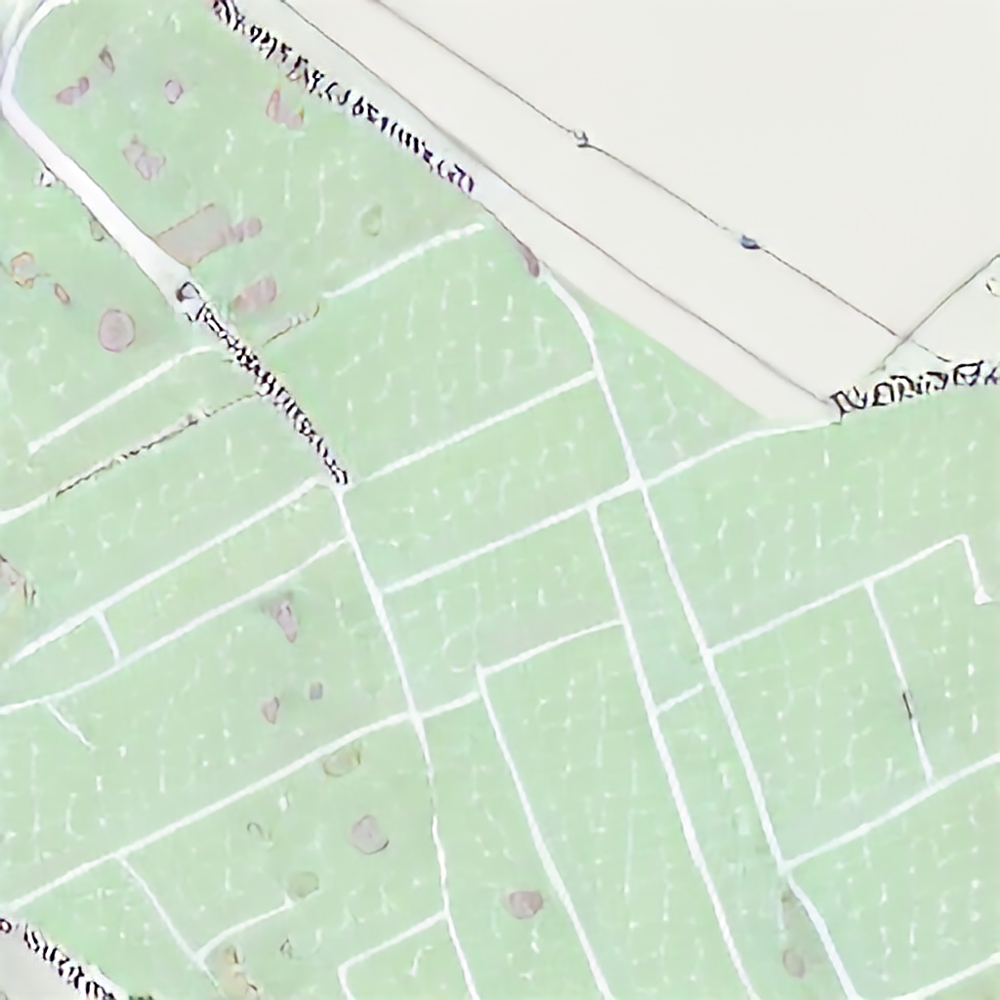

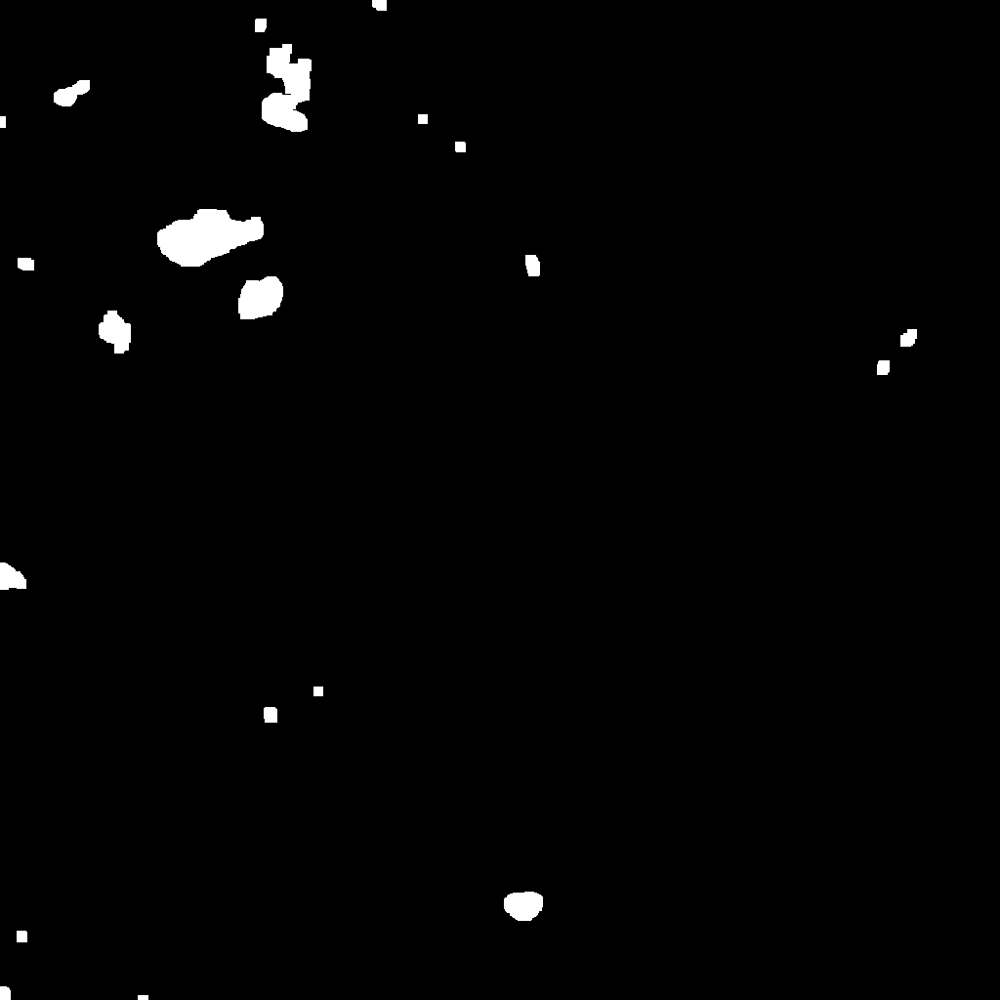

In [21]:


for img in imgs:
    display(img)
    img = pil_to_tensor(img).unsqueeze(0) / 255.0
    out = model.to("cuda").model(img.cuda())[0] > 0.5
    out = out.float().detach().cpu().numpy()

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10))
    out = cv2.erode(
        out[0], kernel=kernel, anchor=(-1, -1), borderType=cv2.BORDER_REPLICATE
    )
    out = cv2.dilate(
        out, kernel=kernel, anchor=(-1, -1), borderType=cv2.BORDER_REPLICATE
    )

    display(to_pil_image((out * 255).astype("uint8")))

In [101]:
from srai.loaders.osm_loaders.filters.popular import get_popular_tags


popular_tags = get_popular_tags(in_wiki_only=True)
{
    "railway": popular_tags["railway"],
    "highway": popular_tags["highway"],
}

{'railway': ['abandoned',
  'buffer_stop',
  'construction',
  'crossing',
  'derail',
  'disused',
  'halt',
  'level_crossing',
  'light_rail',
  'milestone',
  'miniature',
  'narrow_gauge',
  'platform',
  'proposed',
  'rail',
  'railway_crossing',
  'razed',
  'signal',
  'station',
  'stop',
  'subway',
  'subway_entrance',
  'switch',
  'tram',
  'tram_crossing',
  'tram_level_crossing',
  'tram_stop'],
 'highway': ['bridleway',
  'bus_stop',
  'busway',
  'construction',
  'corridor',
  'crossing',
  'cycleway',
  'elevator',
  'emergency_access_point',
  'footway',
  'give_way',
  'living_street',
  'milestone',
  'mini_roundabout',
  'motorway',
  'motorway_junction',
  'motorway_link',
  'passing_place',
  'path',
  'pedestrian',
  'platform',
  'primary',
  'primary_link',
  'proposed',
  'raceway',
  'residential',
  'rest_area',
  'road',
  'secondary',
  'secondary_link',
  'service',
  'services',
  'speed_camera',
  'steps',
  'stop',
  'street_lamp',
  'tertiary',
  